# **IMDb Movie Review Sentiment Analysis using MLP & CNN (TensorFlow)** #

![imdb_movie.png](https://static1.srcdn.com/wordpress/wp-content/uploads/2017/09/IMDB.jpg?q=50&fit=crop&w=943&h=&dpr=1.5)

In [58]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split
import re
import nltk
from nltk.corpus import stopwords
import textwrap
from nltk.corpus import stopwords, wordnet
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Dropout, Embedding, Conv1D, GlobalMaxPooling1D
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# **Sentiment Classification**

Sentiment classification is the task of identifying and categorizing the emotional tone or opinion expressed through textual information. It is commonly used across various applications, ranging from product reviews, social media analysis, and customer feedback.

In this assignment, we will be using deep learning to classify the sentiment of various movies reviews from IMDb. More specifically, we will be building a multilayer perceptron and a convolutional neural network to process and classify reviews into binary sentiments - positive or negative.

## Preparing the Dataset

For this project, we will be using *IMDB Movie Ratings Dataset*. The original dataset consists of 40,000 movie reviews labelled as 1 for positive and 0 for negative.

You can visualize the dataset by running the 2 cells below. Before running them, you will need to upload the movie.csv file by running the cell below.




In [59]:
from google.colab import files
files.upload()

Saving movies_data.csv to movies_data (1).csv


{'movies_data (1).csv': b'text,label\n"A novel by Remarque. A cast that looks great on paper. A left-wing refugee struggling to remain in Paris between the wars. A Gestapo officer undercover.<br /><br />It\'s a pity there\'s no synergy here. The bits and pieces never coalesce.<br /><br />Stories about left-wing refugees in France don\'t have to be this dull. Read Arthur Koestler\'s memoir ""Scum of the Earth"" (if you can find it). Or his chilling ""Dialogue With Death"" (ditto).<br /><br />To me, the only interest in this film lies in some of the incidental details.<br /><br />The leads spend a lot of time drinking calvados, the Norman apple brandy. I welcome any prompting to have a nip of calvados myself. It certainly made this film appear to pass more quickly. But, according to the film, it\'s only sold in cheap, low-class saloons. Vive le tabac parisien! That\'s what I say. References to intoxicating liquors do abound here; that would seem to be a preoccupation of the scenarists.<b

In [60]:
if __name__ == '__main__':
  movies_data = pd.read_csv('movies_data.csv')
  movies_data.head()

In [61]:
if __name__ == '__main__':
  movies_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32000 entries, 0 to 31999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    32000 non-null  object
 1   label   32000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 500.1+ KB


# Data Preprocessing

Before training a deep learning model for sentiment classification, it is important to preprocess the textual data to improve model performance and efficiency. This typically involves steps such as lowercasing, removing punctuation and stopwords, tokenization, and converting text to numerical format using word embeddings. Proper processing helps the model focus on meaningful patterns while reducing noise and spatial dimensions.

In this section, we will use the `re` library to work with **regular expressions**. This library will be used to preprocess and manipulate the text reviews by converting them to lowercase, remove punctuation, handle negations, and clean any HTML/web tags, helping prepare the text for deep learning models.


We will be carrying out all the preprocessing steps which are common across both MLP and CNN models. We will further preprocess text for each model in the subsequent steps.


1. Tokenization: breaking down text into smaller units called tokens, typically words or subwords.
2. Lemmatization: reduces words to their base or dictionary form (lemma). For example, "running" becomes "run", improving model generalization.
3. Word Embeddings: numerical vector representations of words that capture their semantic meaning.

In [62]:
def remove_duplicates(df):
  # Check whether there are duplicate rows in df and remove them.

  df = df.drop_duplicates()

  ###################

  return df

def clean_text(text):

  # 1. Convert to lowercase
  # 2. Remove HTML tags
  # 3. Handle negations, i.e., "not happy" => "not_happy" (don't need to handle other negations)
  # 4. Remove punctuation
  # 5. Remove digits
  # 6. Remove extra whitespace
  # Handle non-string inputs (e.g., NaN, float)

    if not isinstance(text, str):
      return ''

    text = text.lower()


    text = re.sub(r'<.*?>', '', text)


    text = re.sub(r'\bnot\s+(\w+)', r'not_\1', text)


    text = re.sub(r'[^\w\s]', '', text)


    text = re.sub(r'\d+', '', text)


    text = re.sub(r'\s+', ' ', text).strip()

  ###################

    return text

if __name__ == '__main__':
  movies_data = remove_duplicates(movies_data)
  movies_data['cleaned_text'] = movies_data.text.apply(clean_text)

  # Read the first review before after text cleaning to spot any differences.
  print(textwrap.fill(movies_data['text'][0], width=100), end='\n\n')
  print(textwrap.fill(movies_data['cleaned_text'][0], width=100))

A novel by Remarque. A cast that looks great on paper. A left-wing refugee struggling to remain in
Paris between the wars. A Gestapo officer undercover.<br /><br />It's a pity there's no synergy
here. The bits and pieces never coalesce.<br /><br />Stories about left-wing refugees in France
don't have to be this dull. Read Arthur Koestler's memoir "Scum of the Earth" (if you can find it).
Or his chilling "Dialogue With Death" (ditto).<br /><br />To me, the only interest in this film lies
in some of the incidental details.<br /><br />The leads spend a lot of time drinking calvados, the
Norman apple brandy. I welcome any prompting to have a nip of calvados myself. It certainly made
this film appear to pass more quickly. But, according to the film, it's only sold in cheap, low-
class saloons. Vive le tabac parisien! That's what I say. References to intoxicating liquors do
abound here; that would seem to be a preoccupation of the scenarists.<br /><br />I enjoy films set
in France because it

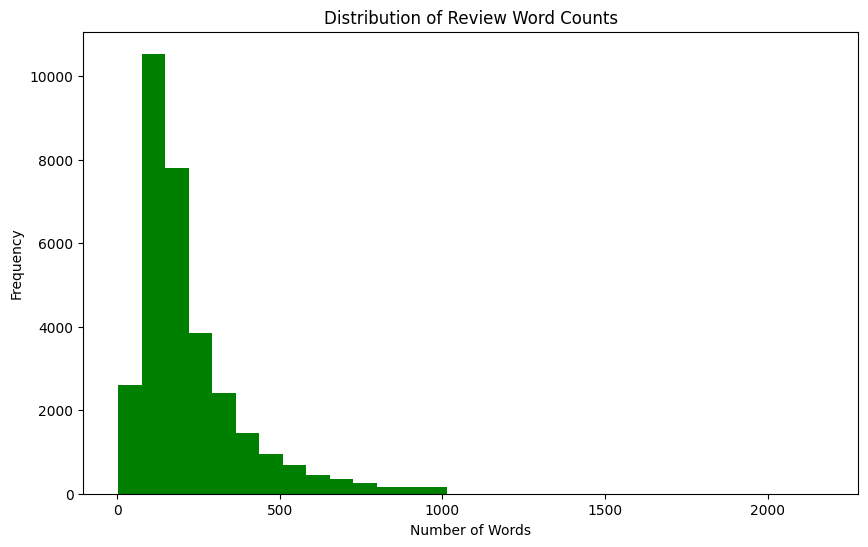

In [63]:
if __name__ == '__main__':
  movies_data['word_count'] = movies_data['cleaned_text'].apply(lambda x: len(x.split()))
  plt.figure(figsize=(10, 6))
  plt.hist(movies_data['word_count'], bins=30, color='green')
  plt.title("Distribution of Review Word Counts")
  plt.xlabel("Number of Words")
  plt.ylabel("Frequency")
  plt.show()

# Multilayer Perceptron

We will now build a Multilayer Perceptron (MLP) model to classify movies reviews. Before training the model, we will perform some additional, but essential, preprocessing steps including lemmatization and TF-IDF vectorization. These steps will help convert our cleaned text into a numerical format suitable for input into the MLP architecture.

**TF-IDF** **(Term Frequency - Inverse Document Frequency)** is a statistical technique used to represent text data numerically. It assigns weights to words based on how frequently they appear in a document (term frequency) and how rare they are across all documents (inverse document frequency). This assists with highlighting words which are more meaningful in distinguishing between classes, while down-weighting common words.

In this section, we will use the **Natural Language Toolkit (NLTK)** - a powerful Python library for working with human language data. NLTK provides tools for tokenization, stopword removal, and lemmatization, which are essential for cleaning and preparing text.



In [64]:
# Download the necessary resources from NLTK
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [65]:
def text_preprocessing_mlp(text):

    # 1. Create the WordNetLemmatizer() object
    # 2. Split text into tokens (a list of words)
    # 3. Remove stopwords and short words (2 letters or less)
    # 4. Lemmatize each word in tokens using the WordNetLemmatizer object

    lemmatizer = WordNetLemmatizer()
    tokens_list = text.split()
    filtered_tokens = [word for word in tokens_list if ((word not in stop_words) and (not len(word) <= 2))]


    tokens = [lemmatizer.lemmatize(word) for word in filtered_tokens]

    ###################
    # This line joins the tokens (a list of words) back into a sentence.
    return ' '.join(tokens)

if __name__ == '__main__':
  movies_data['preprocessed_text_mlp'] = movies_data.cleaned_text.apply(text_preprocessing_mlp)

  print(textwrap.fill(movies_data['cleaned_text'][0], width=100), end='\n\n')
  print(textwrap.fill(movies_data['preprocessed_text_mlp'][0], width=100))

a novel by remarque a cast that looks great on paper a leftwing refugee struggling to remain in
paris between the wars a gestapo officer undercoverits a pity theres no synergy here the bits and
pieces never coalescestories about leftwing refugees in france dont have to be this dull read arthur
koestlers memoir scum of the earth if you can find it or his chilling dialogue with death dittoto me
the only interest in this film lies in some of the incidental detailsthe leads spend a lot of time
drinking calvados the norman apple brandy i welcome any prompting to have a nip of calvados myself
it certainly made this film appear to pass more quickly but according to the film its only sold in
cheap lowclass saloons vive le tabac parisien thats what i say references to intoxicating liquors do
abound here that would seem to be a preoccupation of the scenaristsi enjoy films set in france
because it can be amusing waiting for the inevitable fullsize alcohol ad to pop up on a wall in the
background 

In [66]:
def tfidf_vectorization(df_col, max_features):

  # 1. Create tfidfvectorizer object
  # 2. Apply the object to the dataframe column and return the array

  tfidf = TfidfVectorizer(max_features=max_features)
  result = tfidf.fit_transform(df_col)
  return result

  ###################

if __name__ == '__main__':
  X = tfidf_vectorization(movies_data['preprocessed_text_mlp'], 5000)
  print(X.shape)

(31834, 5000)


In [67]:
def split_dataset(X, df, test_split_ratio=0.2, rand_state=42):
  # Split the dataset into training and testing datasets.

  y = df['label']
  X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_split_ratio, random_state=rand_state
    )
  ###################

  return X_train, X_test, y_train, y_test

if __name__ == '__main__':
  X_train, X_test, y_train, y_test = split_dataset(X, movies_data)

  print("shape of X_train :", X_train.shape)
  print("shape of X_test  :", X_test.shape)
  print("shape of y_train :", y_train.shape)
  print("shape of y_test  :", y_test.shape)

shape of X_train : (25467, 5000)
shape of X_test  : (6367, 5000)
shape of y_train : (25467,)
shape of y_test  : (6367,)


Now it is finally time to build and train your MLP architecture. For simplicity, we are going to use the following 3 layers:
1. `Input()`: defines the shape of the input data that the model will accept. **This is going to be the first layer of your model.** Link: https://www.tensorflow.org/api_docs/python/tf/keras/Input
2. `Dense()`: We are going to choose the number of filters, activation functions, etc via trial and testing..
3. `Dropout()`: We are going to choose your parameter to prevent overfitting, via trial and testing.

Our last layer will be a dense layer with one neuron, representing the probability of the positive class.

After building the desired architecture, we will compile the model with following parameters:
1. `Optimizer`: An algorithm which updates the model's weight during training to minimize the loss function. We are going to use `adam`.
2. `Loss`: A mathematical function which measures how far the model's predictions are from actual labels. We are going to use `binary_crossentropy`.
3. `Metrics`: Evaluation measures used to assess the model performance. We are going to use `accuracy`.


We are going to keep the number of trainable parameters under 1,000,000 for efficient training and to avoid overfitting.


In [68]:
def get_mlp_model():
  # Compile and build your MLP model. Return the compiled Keras model.

  mlp_model = Sequential([
        Input(shape=(5000,)),
        Dense(32, activation='relu'),
        Dropout(0.6),
        Dense(16, activation='relu'),
        Dropout(0.6),
        Dense(1, activation='sigmoid')
        ])

  mlp_model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

  ###################
  return mlp_model

if __name__ == '__main__':
  mlp_model = get_mlp_model()
  mlp_model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_11 (Dense)                │ (None, 32)             │       160,032 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 160,577 (627.25 KB)

 Trainable params: 160,577 (627.25 KB)

 Non-trainable params: 0 (0.00 B)



 **Training and testing of our model**

In [69]:
# Train and test model.

if __name__ == '__main__':
  history = mlp_model.fit(X_train,
                          y_train,
                          epochs=5,
                          batch_size=32,
                          validation_split=0.2)
  loss, accuracy = mlp_model.evaluate(x=X_test, y=y_test, batch_size=8)
  print(f"loss: {loss:.3f}")
  print(f"accuracy: {accuracy:.3f}")
###################

Epoch 1/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.6574 - loss: 0.6047 - val_accuracy: 0.8836 - val_loss: 0.3047
Epoch 2/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - accuracy: 0.8756 - loss: 0.3277 - val_accuracy: 0.8806 - val_loss: 0.2922
Epoch 3/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9090 - loss: 0.2541 - val_accuracy: 0.8759 - val_loss: 0.2949
Epoch 4/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9185 - loss: 0.2339 - val_accuracy: 0.8742 - val_loss: 0.3119
Epoch 5/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - accuracy: 0.9295 - loss: 0.1996 - val_accuracy: 0.8734 - val_loss: 0.3394
796/796 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8777 - loss: 0.3168
loss: 0.328
accuracy: 0.876


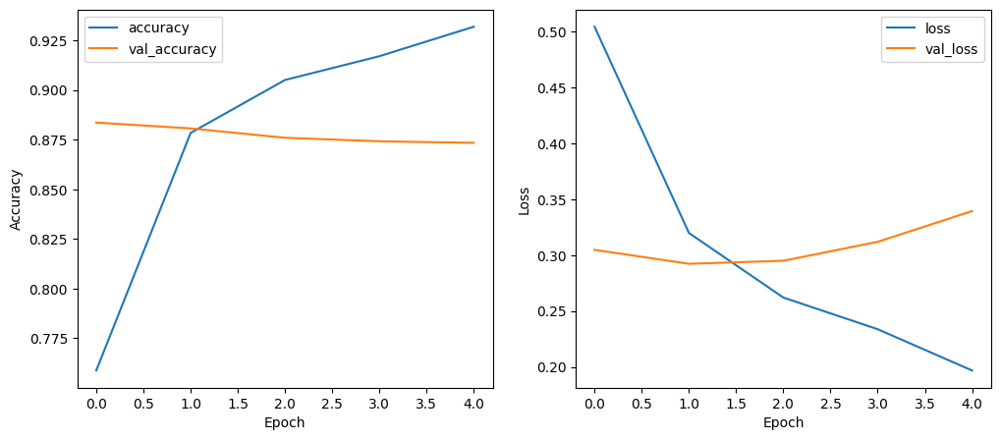

In [70]:
# Plotting our MLP model's training history.
if __name__ == '__main__':
  plt.figure(figsize=(12, 5))

  plt.subplot(1, 2, 1)
  plt.plot(history.history['accuracy'], label='accuracy')
  plt.plot(history.history['val_accuracy'], label='val_accuracy')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy')
  plt.legend()

  plt.subplot(1, 2, 2)
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.legend()

  plt.show()

Now that we have finished training our model, the code will generate predictions (a probability value between 0 and 1) and round it to the nearest integer (the label itself). Finally, the confusion matrix will determine how many labels were predicted correctly and incorrectly.


199/199 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8775 - loss: 0.3172
MLP Accuracy: 0.8759227395057678
199/199 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


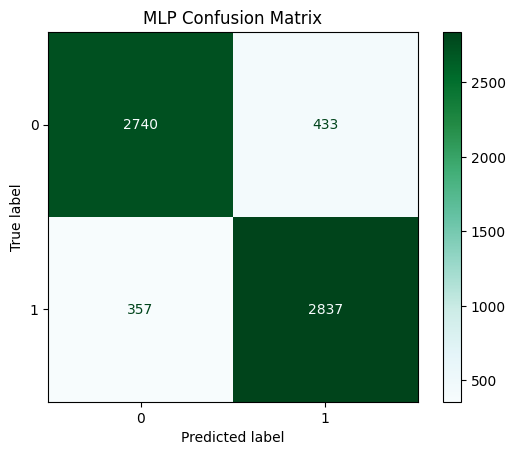

In [71]:
if __name__ == '__main__':
  # Model Evaluation and Confusion Matrix
  loss, accuracy = mlp_model.evaluate(X_test, y_test)
  print(f"MLP Accuracy: {accuracy}")

  predictions = mlp_model.predict(X_test)
  pred_labels = (predictions > 0.5).astype(int)

  cm = confusion_matrix(y_test, pred_labels)

  ConfusionMatrixDisplay(cm, display_labels=[0, 1]).plot(cmap='BuGn')
  plt.title("MLP Confusion Matrix")
  plt.show()

Run the cell below to save the MLP model.

In [72]:
if __name__ == '__main__':
  mlp_model.save("mlp_model.keras")

# Convolutional Neural Network

In this section, we will build a Convolutional Neural Network (CNN) to classify movie reviews as either positive or negative. CNNs are traditionally used in computer vision, but they can also be highly effective for text classification due to their ability to capture local patterns and relationships between words.

Before we train our CNN model, we need to carry some preprocessing on the cleaned text we generated in tasks 1 and 2. More specifically, we will be performing **tokenization** to convert words into sequences of integers, and apply **padding** to ensure uniform input length across all samples.

***Vectorization Vs. Tokenization:***
1. Vectorization is used to convert text into fixed-length numerical vectors based on frequency and importance. Their outputs are usually dense or a sparse vector.
2. Unlike vectorization, tokenization also preserves word order and is used for sequence-based models, including CNNs, RNNs, LSTMs, etc.
3. With tokenization, models can process sequential data and can learn word relationships through embeddings.

In [73]:
def tokenize_text(df_col, num_words=600, max_len=200):
  # Tokenize the data and return the padded sequences.

  # 1. Create Tokenizer() object where num_words is from the input parameter and oov_token is oov_token.
  # oov_token is used to represent words not in the vocabulty (Out Of Vocabulary)
  tokenizer = Tokenizer(num_words=num_words, oov_token='<OOV>')

  # 2. Fit the tokenizer on the cleaned text (df_col).
  tokenizer.fit_on_texts(df_col)

  # 3. Use the tokenizer to convert text into sequences.
  sequences = tokenizer.texts_to_sequences(df_col)

  # 4. Pad the sequences using post padding and truncate from the end (hint: check imported functions).
  padded_sequences = pad_sequences(sequences, maxlen=max_len, padding='post', truncating='post')

  return padded_sequences

if __name__ == '__main__':
  padded_sequences = tokenize_text(movies_data['cleaned_text'])
  print(padded_sequences)

[[  3   1  32 ...  45  60  72]
 [  1   4   1 ...   0   0   0]
 [ 10 281  11 ...   0   0   0]
 ...
 [ 68  10  26 ...   1   1   1]
 [ 11  19   7 ...   1   1 111]
 [ 11   7   3 ...   0   0   0]]


In [74]:
if __name__ == '__main__':
  X_train, X_test, y_train, y_test = split_dataset(padded_sequences, movies_data)


  print("shape of X_train :", X_train.shape)
  print("shape of X_test  :", X_test.shape)
  print("shape of y_train :", y_train.shape)
  print("shape of y_test  :", y_test.shape)

shape of X_train : (25467, 200)
shape of X_test  : (6367, 200)
shape of y_train : (25467,)
shape of y_test  : (6367,)


Now it is finally time to build and train our CNN architecture. We are going to use the following 6 layers:
1. `Input()`: defines the shape of the input data that the model will accept. **This should be the first layer of our model.** Link: https://www.tensorflow.org/api_docs/python/tf/keras/Input
2. `Embedding()`: Converts words into dense vector representations (embeddings). **This should be the second layer of our model.**  
2. `Dense()`: We are going to choose the number of filters, activation functions, etc via trial and testing..
3. `Dropout()`: We are going to choose your parameter to prevent overfitting, via trial and testing
5. `Conv1D`: Applies 1D convolution filters across the sequence to detect word combinations or phrases.
6. `GlobalMaxPooling1D`: Reduces the output of the convolutional layer by selecting the maximum value from each feature map.

Our last layer should be a dense layer with one neuron, representing the probability of the positive class.

After building the desired architecture, we will compile the model with following parameters:
1. `Optimizer`: An algorithm which updates the model's weight during training to minimize the loss function. We are going to use `adam`.
2. `Loss`: A mathematical function which measures how far the model's predictions are from actual labels. We are going to use `binary_crossentropy`.
3. `Metrics`: Evaluation measures used to assess the model performance. We are going to use `accuracy`.

 We will keep the number of trainable parameters under 1,000,000 for efficient training and to avoid overfitting.


In [75]:
def get_cnn_model(max_len):
   # Compile and build your CNN model. Return the compiled Keras model.

  cnn_model = Sequential([
        Input(shape=(max_len,)),
        Embedding(input_dim=601, output_dim=100),
        Conv1D(filters=64, kernel_size=3, activation='relu'),
        GlobalMaxPooling1D(),
        Dense(32, activation='relu'),
        Dropout(0.4),
        Dense(1, activation='sigmoid')
    ])

  cnn_model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )



  ##################
  return cnn_model

if __name__ == '__main__':
  max_len = 200
  cnn_model = get_cnn_model(max_len)
  cnn_model.build(input_shape=(None, max_len))
  cnn_model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_1 (Embedding)         │ (None, 200, 100)       │        60,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 198, 64)        │        19,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling1d_1          │ (None, 64)             │             0 │
│ (GlobalMaxPooling1D)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 81,477 (318.27 KB)

 Trainable params: 81,477 (318.27 KB)

 Non-trainable params: 0 (0.00 B)

**Training and testing our model**

In [76]:
# Train and test your CNN model. Feel free to change the codes below

if __name__ == '__main__':
  history = cnn_model.fit(X_train,
                          y_train,
                          epochs=5,
                          batch_size=32,
                          validation_split=0.2)
  loss, accuracy = cnn_model.evaluate(x=X_test, y=y_test, batch_size=8)
  print(f"loss: {loss:.3f}")
  print(f"accuracy: {accuracy:.3f}")
###################

Epoch 1/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - accuracy: 0.6580 - loss: 0.5954 - val_accuracy: 0.7996 - val_loss: 0.4236
Epoch 2/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 18s 28ms/step - accuracy: 0.8230 - loss: 0.3991 - val_accuracy: 0.8159 - val_loss: 0.3965
Epoch 3/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - accuracy: 0.8600 - loss: 0.3353 - val_accuracy: 0.8214 - val_loss: 0.3804
Epoch 4/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 19s 28ms/step - accuracy: 0.8863 - loss: 0.2826 - val_accuracy: 0.8180 - val_loss: 0.4075
Epoch 5/5
637/637 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - accuracy: 0.9048 - loss: 0.2443 - val_accuracy: 0.8166 - val_loss: 0.4257
796/796 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.8154 - loss: 0.4253
loss: 0.423
accuracy: 0.817


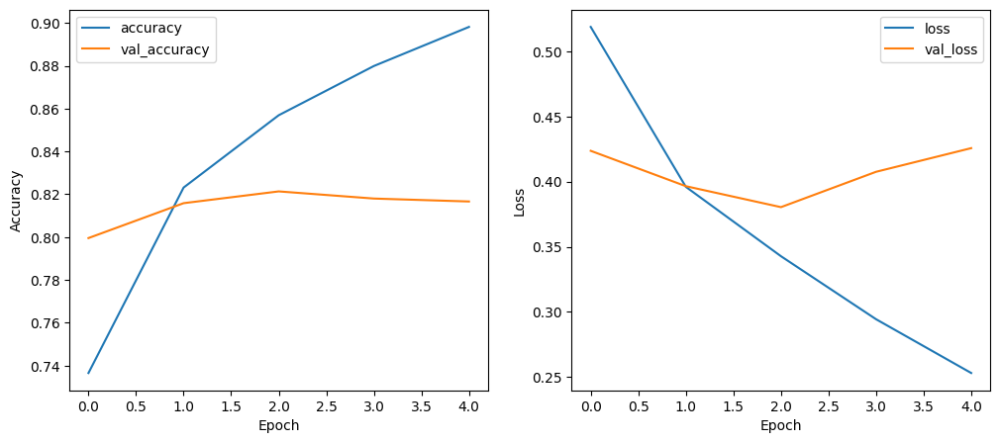

In [77]:
if __name__ == '__main__':
  # Plotting our CNN model's training history.
  plt.figure(figsize=(12, 5))

  plt.subplot(1, 2, 1)
  plt.plot(history.history['accuracy'], label='accuracy')
  plt.plot(history.history['val_accuracy'], label='val_accuracy')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy')
  plt.legend()

  plt.subplot(1, 2, 2)
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.legend()

  plt.show()

199/199 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8153 - loss: 0.4250
CNN Accuracy: 0.8165541291236877
199/199 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step


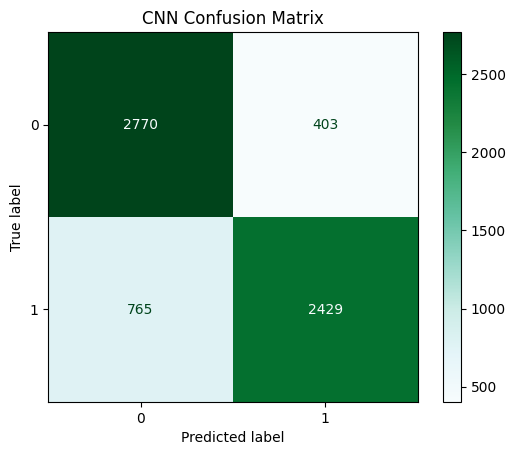

In [78]:
if __name__ == '__main__':
  loss, accuracy = cnn_model.evaluate(X_test, y_test)
  print(f"CNN Accuracy: {accuracy}")

  predictions = cnn_model.predict(X_test)
  pred_labels = (predictions > 0.5).astype(int)

  cm = confusion_matrix(y_test, pred_labels)

  ConfusionMatrixDisplay(cm, display_labels=[0, 1]).plot(cmap='BuGn')
  plt.title("CNN Confusion Matrix")
  plt.show()

You can  run the cell below to save the CNN model.

In [79]:
if __name__ == '__main__':
  cnn_model.save("cnn_model.keras")